# Explorative Data Analysis
Exploring AirBnB listings in Paris
Source: https://www.kaggle.com/vaibhav2025/airbnb-listings-reviews
Dataset file is original one preprocessed by PrepData notebook


Importing libraries, we'll start with numerical and text columns followed up by categorical and maps

In [2]:
import pandas as pd
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
import matplotlib as mp
from wordcloud import WordCloud,STOPWORDS
from PIL import Image
import folium
import folium.plugins as plugins

In [3]:
df = pd.read_csv('Airbnb_Data/prepListings.csv', low_memory=False)
df.columns

Index(['listing_id', 'name', 'host_since', 'host_location',
       'host_is_superhost', 'host_total_listings_count',
       'host_identity_verified', 'neighbourhood', 'latitude', 'longitude',
       'property_type', 'room_type', 'accommodates', 'bedrooms', 'price',
       'minimum_nights', 'maximum_nights', 'review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value', 'instant_bookable',
       'parking', 'Hot_water', 'Air_conditioning', 'Lockbox',
       'Ethernet connection', 'balcony', 'Private_entrance', 'TV',
       'Dedicated_workspace', 'Refrigerator', 'Cooking', 'Bathtub', 'Shower',
       'price_category'],
      dtype='object')

### Density plot with dates of host's first listing

<AxesSubplot:ylabel='Density'>

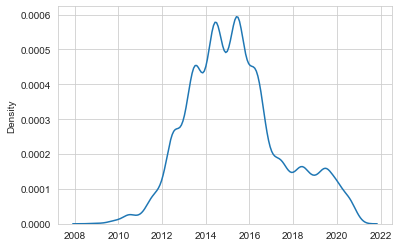

In [4]:
df['host_since'] = pd.to_datetime(df.host_since)
sns.set_style('whitegrid')
sns.kdeplot(np.array(df.host_since))

<AxesSubplot:ylabel='Density'>

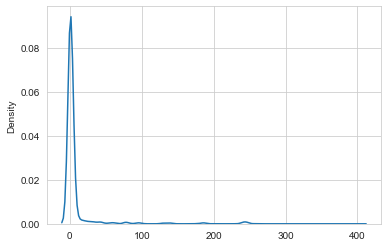

In [9]:

sns.set_style('whitegrid')
sns.kdeplot(np.array(df.host_total_listings_count))

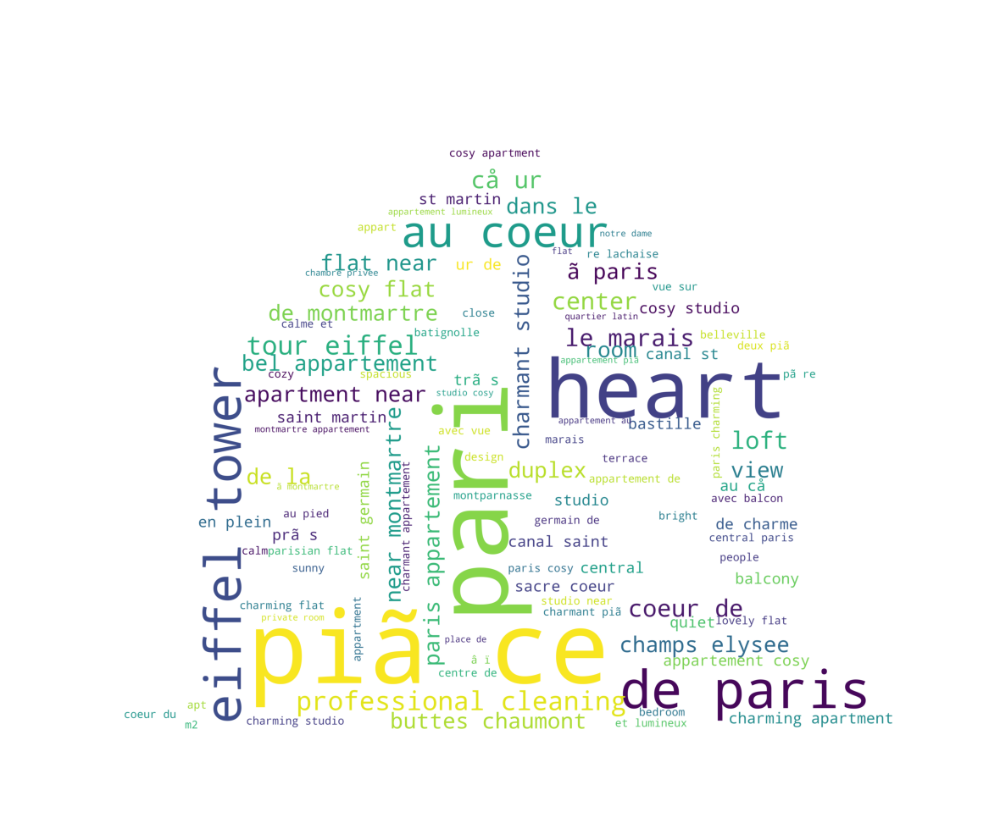

In [7]:
house = np.array(Image.open('Airbnb_Data/domek.jpg'))
df['name'] = df.name.apply(str)
names = ' '.join(df['name'].str.lower().values)
wordcloud = WordCloud(background_color='white',
                        height=900,
                        width=800,
                        scale=20,
                        prefer_horizontal=0.9999,
                        mask=house
                     ).generate(names)
plt.figure(figsize=[25, 18])
plt.imshow(wordcloud)
plt.axis('off')
#plt.savefig('WordName.jpg', dpi=900, bbox_inches='tight', quality=95)
plt.show()

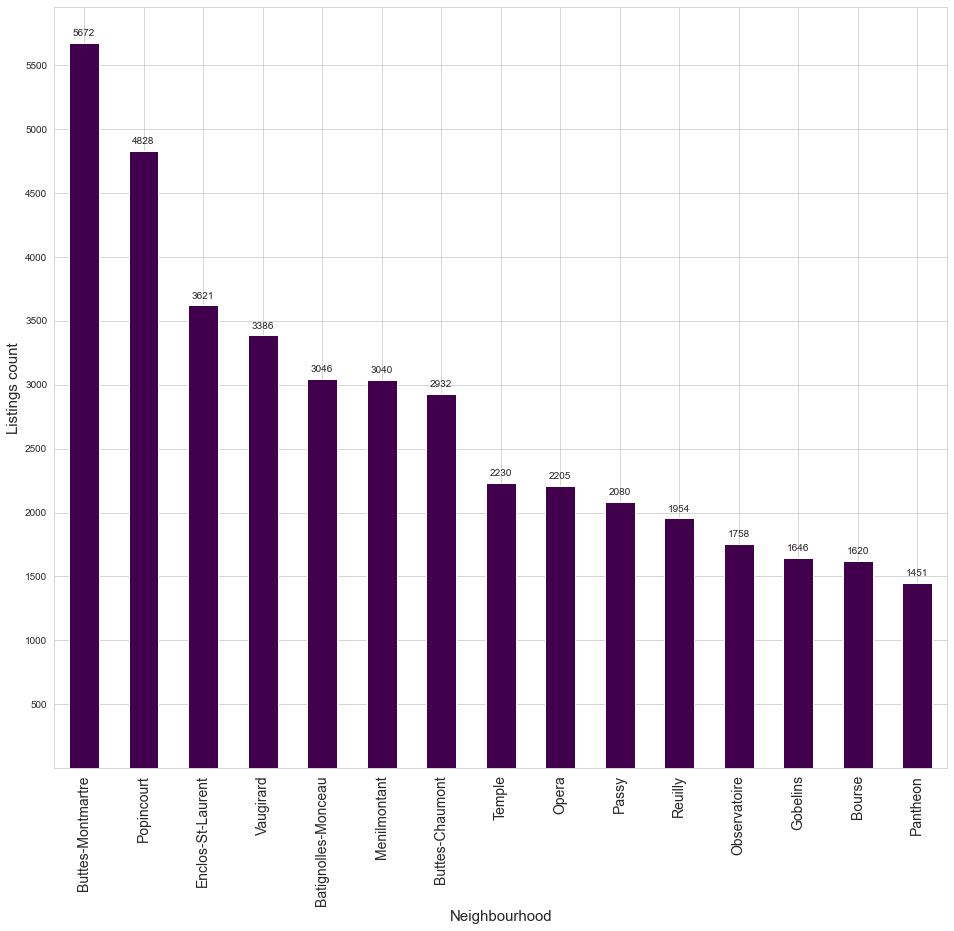

In [18]:
fig = plt.figure(figsize=(16,14))



ax = df.groupby('neighbourhood').nunique()['listing_id'].sort_values(ascending=False)[:15].plot(kind='bar',colormap='PRGn')
def barValuesVert(ax, spacing=5):

    for rect in ax.patches:
        y_value = rect.get_height()
        x_value = rect.get_x() + rect.get_width() / 2
        space = spacing
        va = 'bottom'


        label = "{:d}".format(y_value)
        ax.annotate(
            label,
            (x_value, y_value),
            xytext=(0, space),
            textcoords="offset points",
            ha='center',
            va=va)

barValuesVert(ax)
plt.ylabel('Listings count',fontsize=15)
plt.xlabel('Neighbourhood',fontsize=15)
plt.xticks(fontsize = 14)
plt.grid
plt.yticks(np.arange(500,5501,500))


plt.show()

In [5]:
from folium.plugins import HeatMap
mapPoint = folium.Map([48.86,2.38],zoom_start=12)
for index, row in df.iterrows():
    if df.price_category[index] == 'Cheap':
        folium.CircleMarker( location=[df.latitude[index], df.longitude[index]],color='blue', radius=1 ).add_to( mapPoint )
    elif df.price_category[index] == 'Average':
        folium.CircleMarker( location=[df.latitude[index], df.longitude[index]],color='orange', radius=1 ).add_to( mapPoint )
    elif df.price_category[index] == 'Expansive':
        folium.CircleMarker( location=[df.latitude[index], df.longitude[index]],color='red', radius=1 ).add_to( mapPoint )



#mapPoint.save( 'PointMap.html')
display(mapPoint)

In [39]:

mapHeat = folium.Map([48.86,2.38],zoom_start=12)
HeatMap(df[['latitude','longitude']].dropna(),radius=8,gradient={0.2:'blue',0.4:'purple',0.6:'orange',1.0:'red'}).add_to(mapHeat)

#mapHeat.save( 'HeatMap.html')
display(mapHeat)

<ipython-input-33-945c0f86f323>:3: UserWarning:

To output multiple subplots, the figure containing the passed axes is being cleared



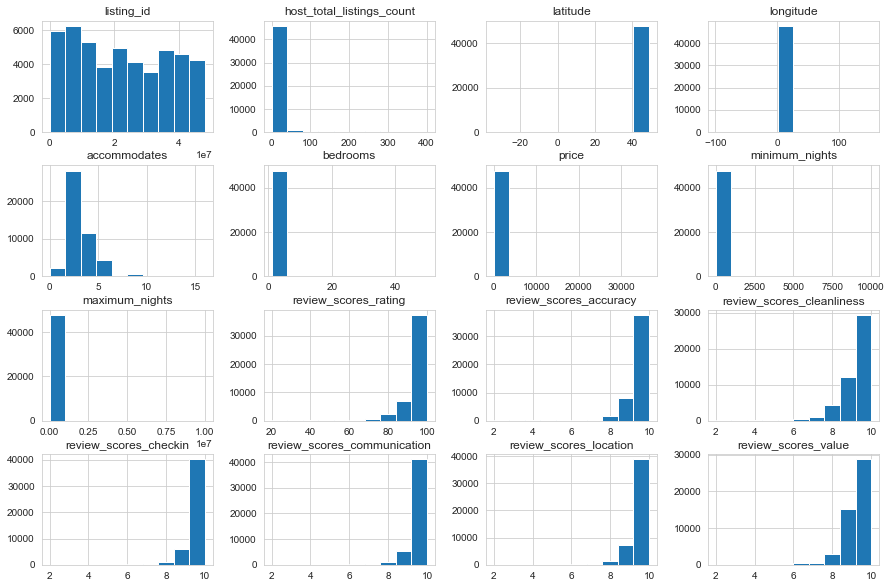

In [33]:
fig = plt.figure(figsize = (15,10))
ax = fig.gca()
df.hist(ax=ax)
plt.show()